# 3. Fitting diads once you have groups
- Once you have divided your diads into groups based on strengths, you need to tweak the fit parameters for each group
- Then you can loop through all files in a given group and automatically fit the spectra

In [117]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import joblib
import DiadFit as pf
pf.__version__

'0.0.81'

## Specifying filetype, and folder as before

In [118]:
# This specifies what file type your Raman exported in. 
meta_path, spectra_path, filetype, prefix, prefix_str, file_ext, TruPower=pf.get_settings()

## Load in data and fit parameters
- This loads in the dataframes of the fit parameters you saved in the other file, by group
- At this point you select what group you want to fit (batch = 'Weak', 'Medium' or 'Strong'). After running through the entire notebook for one group, come back up here to fit a second group.

In [119]:
## load dataframes and numpy arrays 
np_x = joblib.load('np_x.sav')

# Select the group you want to fit ('Weak', 'Medium', 'Strong'). After selecting one, go through and select another one and run again from here. 
batch='Weak' # Options are Weak, Medium, Strong

if batch=='Weak':
    GroupN_df=joblib.load('Weak_df.sav')
if batch=='Medium':
    GroupN_df=joblib.load('Medium_df.sav')
if batch=='Strong':
    GroupN_df=joblib.load('Strong_df.sav')

### Now load one file from this group to tweak parameters for

In [120]:
Diad_Files =GroupN_df['filename']
i=0


### Lets plot the diad to have a look at it

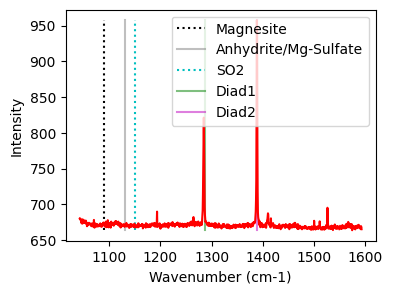

In [121]:
plot1=pf.plot_diad(path=spectra_path, filename=Diad_Files[i], filetype=filetype)

## Now lets inspect the diads and get their approximate positions
- As with generic peak, you can exclude 2 segments (e.g. around cosmic rays)
- You then specify how many peaks you want to fit on each diad. 1 means just the strong peak, 2 hotbands, and 3 for Diad2 would also fit the C13 peak if present. 
- The identify_diad_peaks then uses scipy findpeaks to identify the positions of the 2 diads, and any other peaks the user asks for. These are saved, and fed into the later functions for peak fitting. 

## Choose a model for fitting all peaks
- Option of Voigt or PseudoVoigt. We recomend PsuedoVoigt

In [122]:
model_name='PseudoVoigtModel'

## Fit Diad 1
- Tweak the parameters in the config files for each group. E.g. how many peaks (fit_peaks), the background positions, the sigma of the diad, and whether or not you want a gaussian background

In [123]:
diad_id_config=pf.diad_id_config(height=50, exclude_range1=[1308, 1309])
diad_id_config

if batch=='Weak':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1250),
    upper_bck_diad1=(1300, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Medium':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=2, lower_bck_diad1=(1180, 1240),
    upper_bck_diad1=(1315, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Strong':
    diad1_fit_config_init=pf.diad1_fit_config(
    fit_gauss=True, gauss_amp= 2*GroupN_df['HB1_abs_prom'].iloc[i],
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1220),
    upper_bck_diad1=(1330, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=1000, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
diad1_fit_config_init

diad1_fit_config(model_name='PseudoVoigtModel', fit_peaks=2, N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1250), upper_bck_diad1=(1300, 1350), fit_gauss=False, gauss_amp=1000, diad_sigma=0.6, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=152.18750965313734, HB_prom=nan, x_range_baseline=30, y_range_baseline=100, dpi=200, x_range_residual=10, return_other_params=False)

### See what these fit parameters look like for diad1

,Diad1_Combofit_Cent,Diad1_Voigt_Cent,Diad1_cent_err,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Voigt_Gamma,Diad1_Combofit_Height,Diad1_Residual,Diad1_Prop_Lor,Diad1_fwhm,Diad1_refit,Diad1_Asym50,Diad1_Asym70,Diad1_Yuan2017_sym_factor,Diad1_Remigi2021_BSF
0,1284.397403,1284.397403,0.012414,402.958263,0.994384,0,151.220446,1.992971,0.645758,1.988768,Flagged Warnings:,1.168831,1.206077,0.335766,0.013151


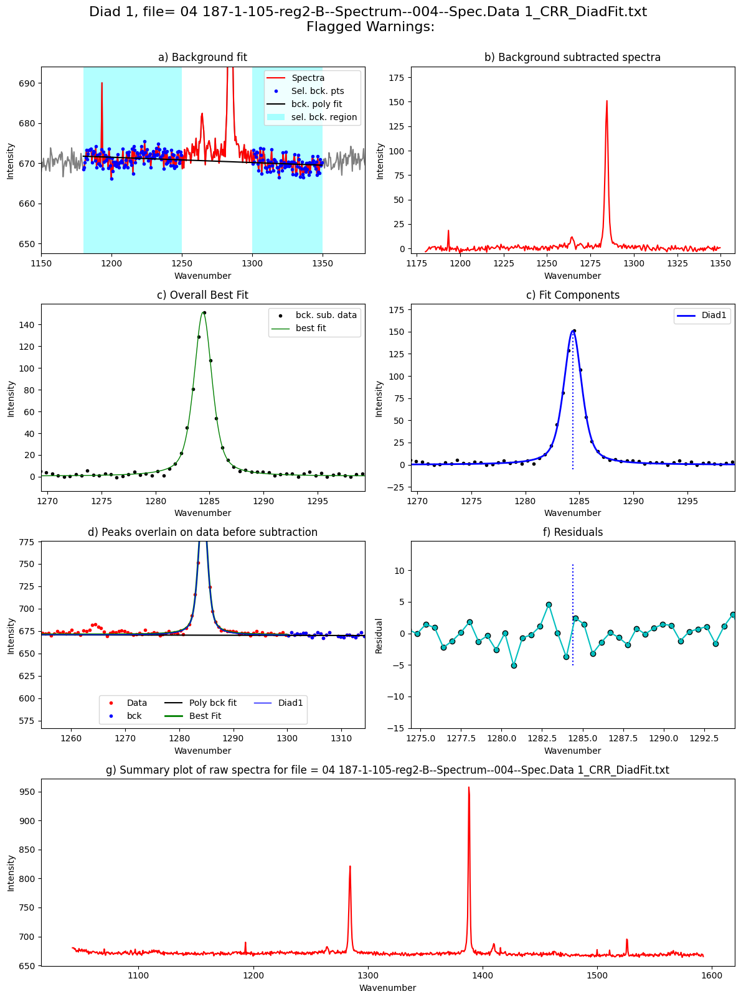

In [124]:
Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config_init,
config2=diad_id_config,
path=spectra_path, filename=Diad_Files.iloc[i],
filetype=filetype, plot_figure=True, close_figure=False,
Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
HB_pos=GroupN_df['HB1_pos'].iloc[i])
Diad1_fit

### Update the sigma
- The sigma parameter varies quite a lot based on the splitting. Best to update your first guess with what you found for the example file above

In [125]:
diad1_fit_config2=diad1_fit_config_init

## Fit diad2

In [126]:
if batch=='Weak':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=2, upper_bck_diad2=(1430, 1480),
    lower_bck_diad2=(1310, 1360), diad_sigma=0.4,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Medium':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3, fit_gauss=True, gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i],
    lower_bck_diad2=(1310, 1350), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Strong':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3, fit_gauss=True, gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i],
    lower_bck_diad2=(1310, 1340), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=1000,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init
diad2_fit_config_init

diad2_fit_config(model_name='PseudoVoigtModel', fit_peaks=2, N_poly_bck_diad2=2, lower_bck_diad2=(1310, 1360), upper_bck_diad2=(1430, 1480), fit_gauss=False, gauss_amp=1000, diad_sigma=0.4, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=305.84379922009066, HB_prom=nan, x_range_baseline=30, y_range_baseline=100, plot_figure=True, dpi=200, x_range_residual=30, return_other_params=False, C13_prom=10)

### See what these fit parameters look like for diad2

,Diad2_Combofit_Cent,Diad2_Voigt_Cent,Diad2_cent_err,Diad2_Voigt_Area,Diad2_Voigt_Sigma,Diad2_Voigt_Gamma,Diad2_Combofit_Height,Diad2_Residual,Diad2_Prop_Lor,Diad2_fwhm,Diad2_refit,Diad2_Asym50,Diad2_Asym70,Diad2_Yuan2017_sym_factor,Diad2_Remigi2021_BSF
0,1388.239958,1388.239958,0.0055,622.714485,0.730436,0,313.910129,2.202893,0.673696,1.460873,Flagged Warnings:,1.067442,1.087179,0.098524,0.004654


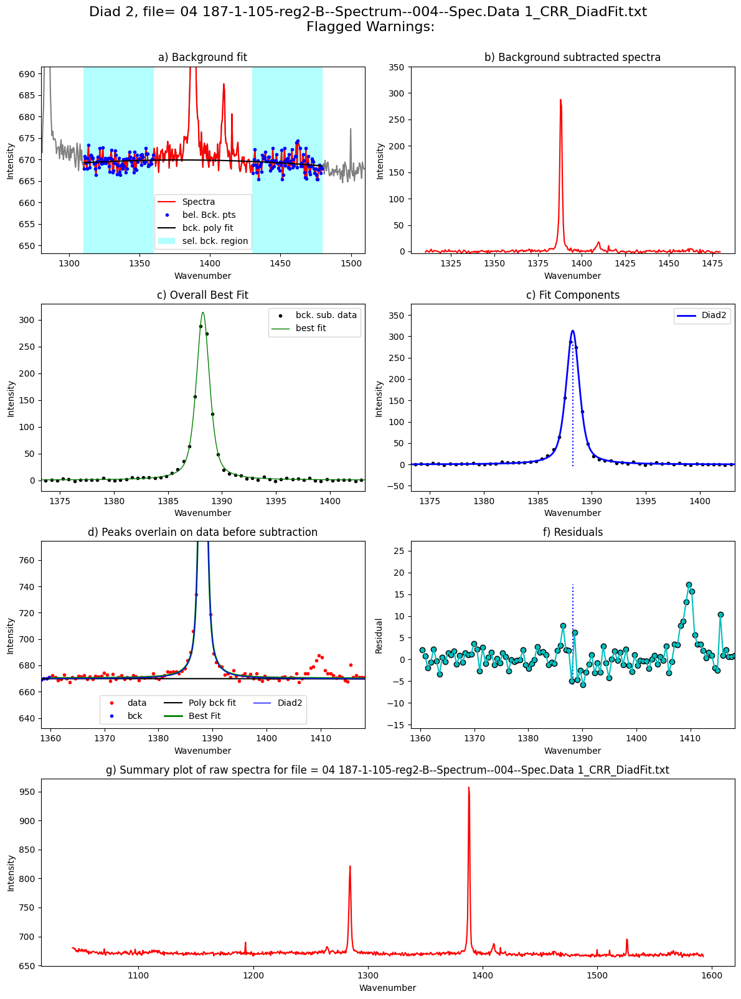

In [127]:
Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
    config2=diad_id_config,
path=spectra_path, filename=Diad_Files[i], filetype=filetype,
plot_figure=True, close_figure=False, 
Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
HB_pos=GroupN_df['HB2_pos'].iloc[i], 
C13_pos=GroupN_df['C13_pos'].iloc[i])
Diad2_fit.to_clipboard(excel=True)
Diad2_fit

## Loop over all the files in the group
- This will loop over all the 

  0%|          | 0/53 [00:00<?, ?it/s]

Processing file: 04 187-1-105-reg2-B--Spectrum--004--Spec.Data 1_CRR_DiadFit.txt


  2%|▏         | 1/53 [00:02<02:00,  2.31s/it]

Processing file: 05 187-1-105-reg2-B--Spectrum--005--Spec.Data 1_CRR_DiadFit.txt


  4%|▍         | 2/53 [00:04<01:48,  2.13s/it]

Processing file: 06 187-1-105-reg2-B--Spectrum--006--Spec.Data 1_CRR_DiadFit.txt


  6%|▌         | 3/53 [00:06<01:49,  2.18s/it]

Processing file: 07 187-1-105-reg3-A--Spectrum--012--Spec.Data 1_CRR_DiadFit.txt


  8%|▊         | 4/53 [00:08<01:43,  2.10s/it]

Processing file: 09 187-1-105-reg3-A--Spectrum--016--Spec.Data 1.txt


  9%|▉         | 5/53 [00:10<01:39,  2.07s/it]

Processing file: 10 187-1-105-reg3-A--Spectrum--017--Spec.Data 1.txt


 11%|█▏        | 6/53 [00:12<01:40,  2.14s/it]

Processing file: 12 187-1-105-reg3-B--Spectrum--021--Spec.Data 1.txt


 13%|█▎        | 7/53 [00:14<01:36,  2.10s/it]

Processing file: 13 187-1-105-reg3-B--Spectrum--022--Spec.Data 1.txt


 15%|█▌        | 8/53 [00:16<01:30,  2.01s/it]

Processing file: 14 187-1-105-reg3-B--Spectrum--023--Spec.Data 1_CRR_DiadFit.txt


 17%|█▋        | 9/53 [00:18<01:25,  1.95s/it]

Processing file: 16 187-1-105-reg3-C--Spectrum--027--Spec.Data 1.txt


 19%|█▉        | 10/53 [00:20<01:25,  1.99s/it]c:\users\charl\documents\python dev\diadfit\src\DiadFit\diads.py:3037: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,axes=plt.subplot_mosaic(mosaic=figure_mosaic, figsize=(12, 16))


Processing file: 17 187-1-105-reg3-C--Spectrum--028--Spec.Data 1.txt


 21%|██        | 11/53 [00:22<01:21,  1.94s/it]

Processing file: 18 187-1-105-reg3-C--Spectrum--029--Spec.Data 1.txt


 23%|██▎       | 12/53 [00:24<01:17,  1.90s/it]

Processing file: 21 187-1-105-reg4-A--Spectrum--042--Spec.Data 1.txt


 25%|██▍       | 13/53 [00:26<01:15,  1.89s/it]

Processing file: 23 187-1-105-reg4-A--Spectrum--044--Spec.Data 1.txt


 26%|██▋       | 14/53 [00:27<01:12,  1.86s/it]

Processing file: 24 187-1-105-reg4-A--Spectrum--045--Spec.Data 1.txt


 28%|██▊       | 15/53 [00:30<01:14,  1.95s/it]

Processing file: 26 187-1-105-reg4-B--Spectrum--049--Spec.Data 1.txt


 30%|███       | 16/53 [00:31<01:11,  1.92s/it]

Processing file: 27 187-1-105-reg4-B--Spectrum--050--Spec.Data 1_CRR_DiadFit.txt


 32%|███▏      | 17/53 [00:33<01:08,  1.90s/it]

Processing file: 28 187-1-105-reg4-B--Spectrum--051--Spec.Data 1_CRR_DiadFit.txt


 34%|███▍      | 18/53 [00:35<01:05,  1.87s/it]

Processing file: 36 187-1-105-reg4-C--Spectrum--061--Spec.Data 1.txt


 36%|███▌      | 19/53 [00:37<01:04,  1.90s/it]

Processing file: 37 187-1-105-reg4-C--Spectrum--062--Spec.Data 1.txt


 38%|███▊      | 20/53 [00:39<01:03,  1.92s/it]

Processing file: 38 187-1-105-reg4-C--Spectrum--063--Spec.Data 1.txt


 40%|███▉      | 21/53 [00:41<01:05,  2.03s/it]

Processing file: 40 187-1-106-A--Spectrum--074--Spec.Data 1_CRR_DiadFit.txt


 42%|████▏     | 22/53 [00:43<01:03,  2.03s/it]

Processing file: 41 187-1-106-A--Spectrum--075--Spec.Data 1.txt


 43%|████▎     | 23/53 [00:45<01:01,  2.04s/it]

Processing file: 42 187-1-106-A--Spectrum--076--Spec.Data 1.txt


 45%|████▌     | 24/53 [00:47<00:58,  2.01s/it]

Processing file: 44 187-1-106-B--Spectrum--080--Spec.Data 1.txt


 47%|████▋     | 25/53 [00:49<00:56,  2.03s/it]

Processing file: 45 187-1-106-B--Spectrum--081--Spec.Data 1.txt


 49%|████▉     | 26/53 [00:51<00:55,  2.04s/it]

Processing file: 46 187-1-106-B--Spectrum--082--Spec.Data 1.txt


 51%|█████     | 27/53 [00:54<00:53,  2.05s/it]

Processing file: 48 187-1-107-A--Spectrum--091--Spec.Data 1_CRR_DiadFit.txt


 53%|█████▎    | 28/53 [00:56<00:52,  2.11s/it]

Processing file: 49 187-1-107-A--Spectrum--092--Spec.Data 1.txt


 55%|█████▍    | 29/53 [00:58<00:48,  2.04s/it]

Processing file: 50 187-1-107-A--Spectrum--093--Spec.Data 1_CRR_DiadFit.txt


 57%|█████▋    | 30/53 [01:00<00:45,  1.99s/it]

Processing file: 52 187-1-107-B--Spectrum--097--Spec.Data 1_CRR_DiadFit.txt


 58%|█████▊    | 31/53 [01:01<00:42,  1.95s/it]

Processing file: 53 187-1-107-B--Spectrum--098--Spec.Data 1.txt


 60%|██████    | 32/53 [01:03<00:40,  1.93s/it]

Processing file: 54 187-1-107-B--Spectrum--099--Spec.Data 1.txt


 62%|██████▏   | 33/53 [01:05<00:38,  1.91s/it]

Processing file: 55 187-1-107-A--Spectrum--100--Spec.Data 1_CRR_DiadFit.txt


 64%|██████▍   | 34/53 [01:07<00:36,  1.92s/it]

Processing file: 56 187-1-107-A--Spectrum--101--Spec.Data 1.txt


 66%|██████▌   | 35/53 [01:09<00:34,  1.92s/it]

Processing file: 57 187-1-107-A--Spectrum--102--Spec.Data 1.txt


 68%|██████▊   | 36/53 [01:11<00:32,  1.92s/it]

Processing file: 60 187-1-107-C--Spectrum--107--Spec.Data 1_CRR_DiadFit.txt


 70%|██████▉   | 37/53 [01:13<00:32,  2.06s/it]

Processing file: 61 187-1-107-C--Spectrum--108--Spec.Data 1.txt


 72%|███████▏  | 38/53 [01:15<00:29,  2.00s/it]

Processing file: 62 187-1-107-C--Spectrum--109--Spec.Data 1.txt


 74%|███████▎  | 39/53 [01:17<00:28,  2.01s/it]

Processing file: 70 187-1-107-D--Spectrum--120--Spec.Data 1_CRR_DiadFit.txt


 75%|███████▌  | 40/53 [01:19<00:25,  1.98s/it]

Processing file: 71 187-1-107-D--Spectrum--121--Spec.Data 1.txt


 77%|███████▋  | 41/53 [01:21<00:23,  1.95s/it]

Processing file: 72 187-1-107-D--Spectrum--122--Spec.Data 1.txt


 79%|███████▉  | 42/53 [01:23<00:21,  1.93s/it]

Processing file: 74 187-1-108-A--Spectrum--131--Spec.Data 1_CRR_DiadFit.txt


 81%|████████  | 43/53 [01:25<00:18,  1.90s/it]

Processing file: 75 187-1-108-A--Spectrum--132--Spec.Data 1.txt


 83%|████████▎ | 44/53 [01:26<00:16,  1.88s/it]

Processing file: 76 187-1-108-A--Spectrum--133--Spec.Data 1.txt


 85%|████████▍ | 45/53 [01:28<00:15,  1.88s/it]

Processing file: 78 187-1-109-A--Spectrum--140--Spec.Data 1_CRR_DiadFit.txt


 87%|████████▋ | 46/53 [01:30<00:13,  1.89s/it]

Processing file: 79 187-1-109-B--Spectrum--144--Spec.Data 1.txt


 89%|████████▊ | 47/53 [01:32<00:11,  1.90s/it]

Processing file: 80 187-1-109-B--Spectrum--145--Spec.Data 1.txt


 91%|█████████ | 48/53 [01:35<00:10,  2.11s/it]

Processing file: 81 187-1-109-B--Spectrum--146--Spec.Data 1.txt


 92%|█████████▏| 49/53 [01:37<00:08,  2.06s/it]

Processing file: 82 187-1-109-C--Spectrum--149--Spec.Data 1.txt


 94%|█████████▍| 50/53 [01:39<00:06,  2.00s/it]

Processing file: 83 187-1-109-D--Spectrum--153--Spec.Data 1.txt


 96%|█████████▌| 51/53 [01:41<00:03,  1.99s/it]

Processing file: 85 187-1-110-A--Spectrum--158--Spec.Data 1.txt


 98%|█████████▊| 52/53 [01:42<00:01,  1.95s/it]

Processing file: 88 187-1-110-B--Spectrum--165--Spec.Data 1.txt


100%|██████████| 53/53 [01:44<00:00,  1.98s/it]


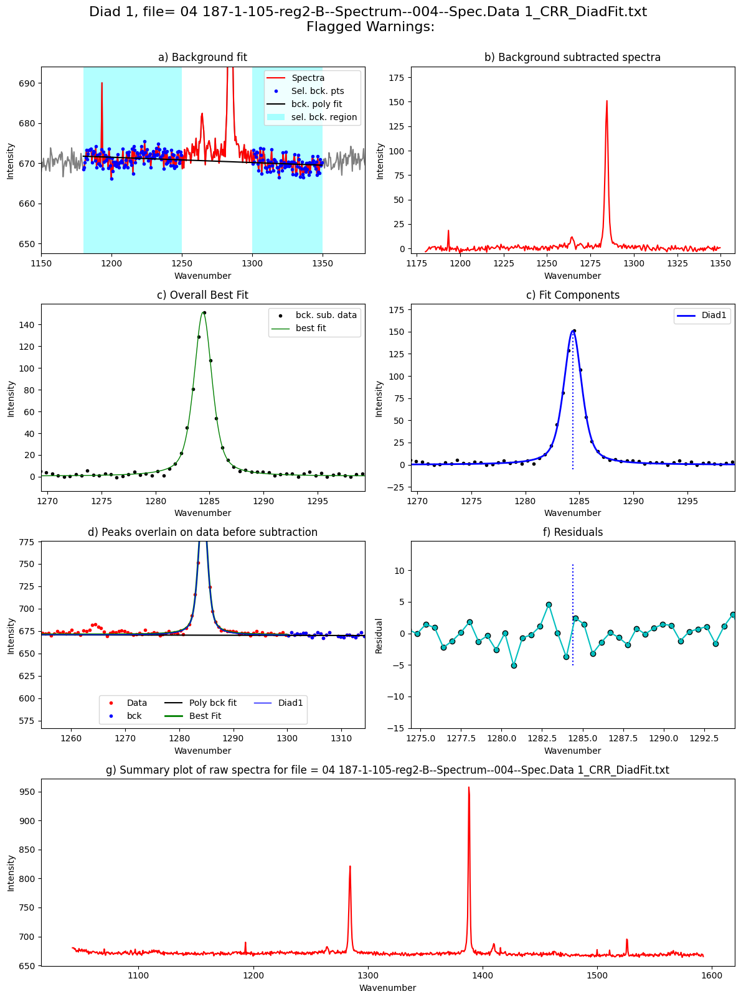

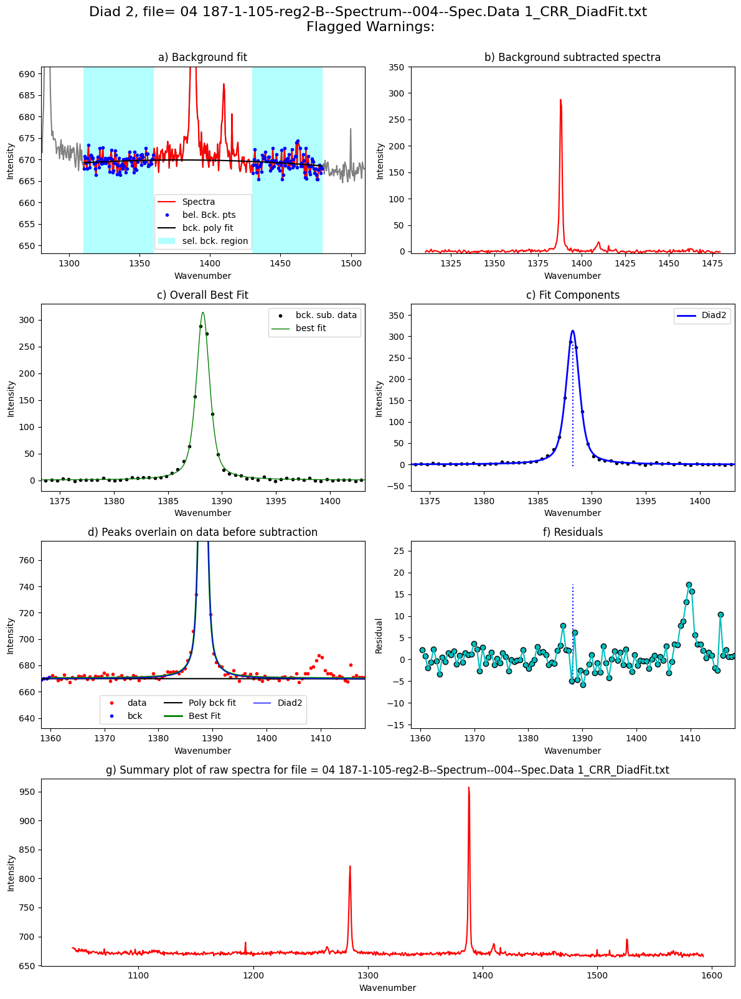

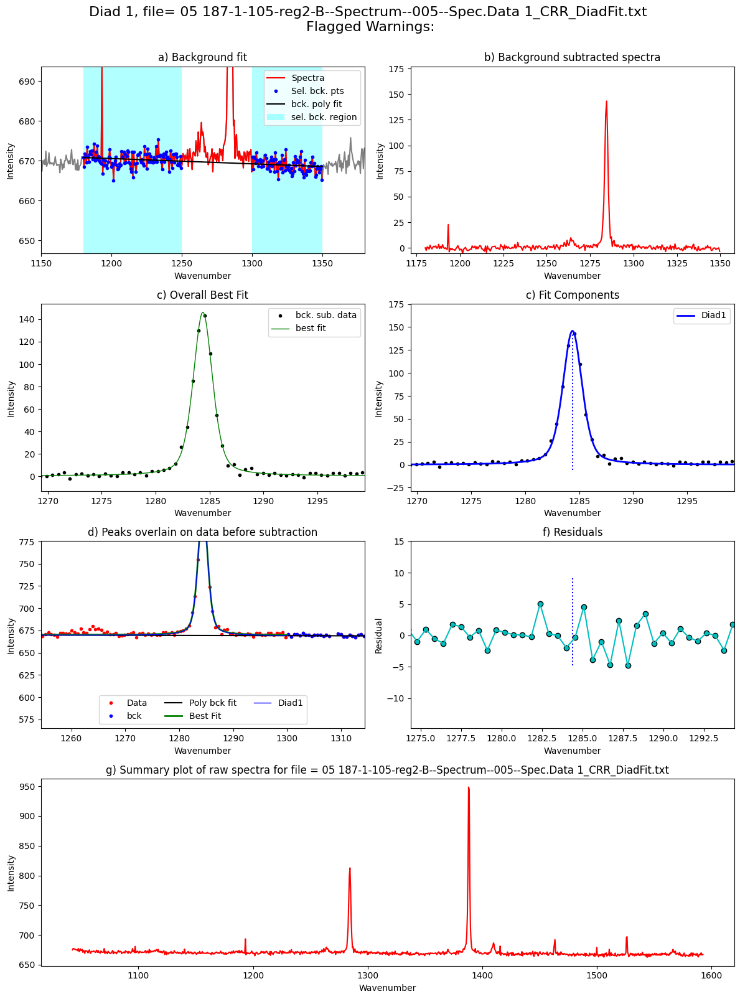

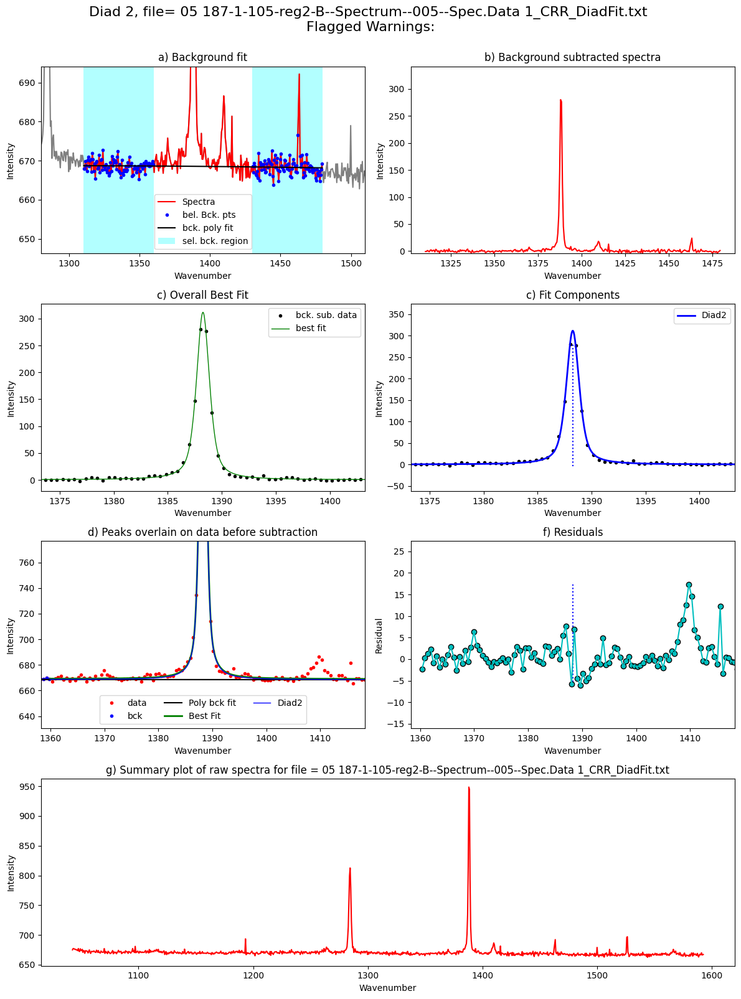

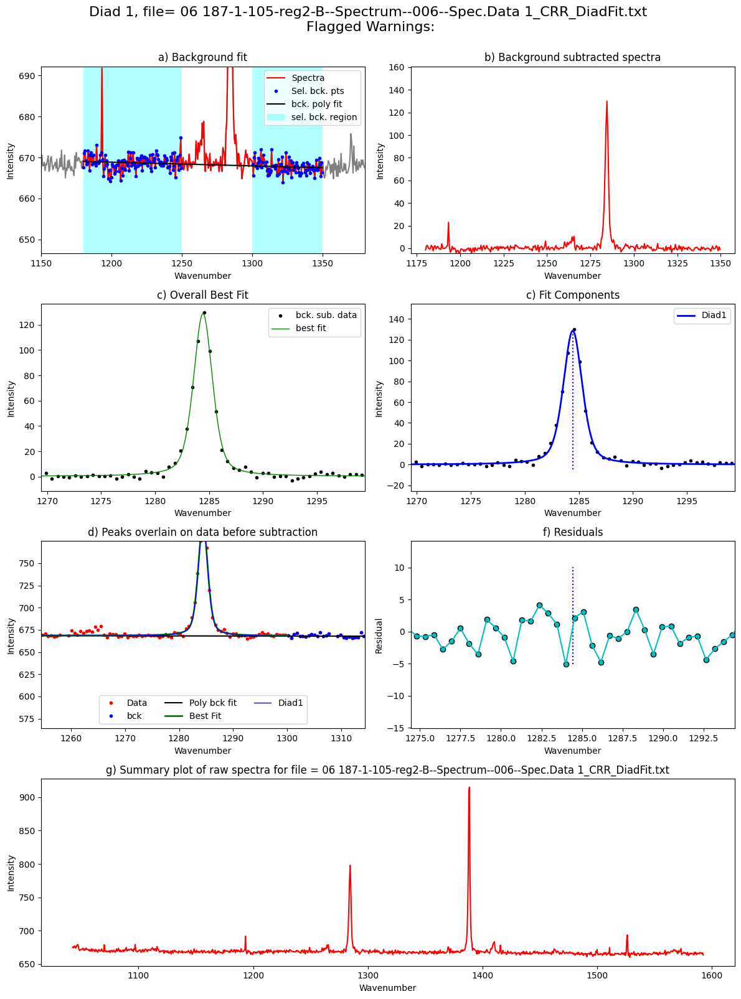

...

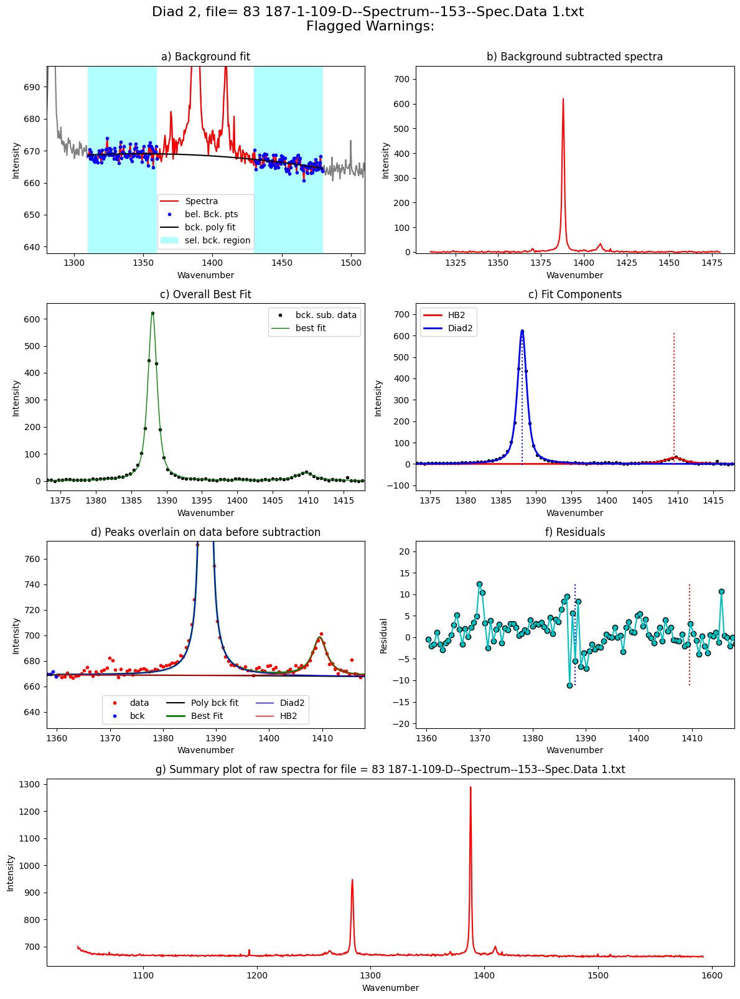

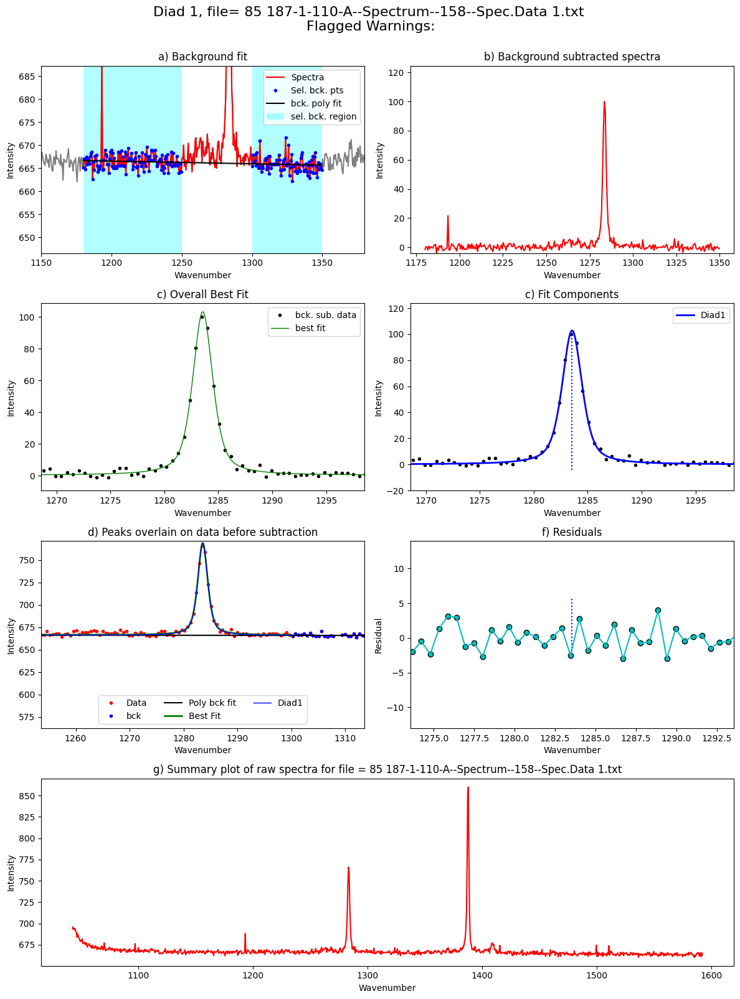

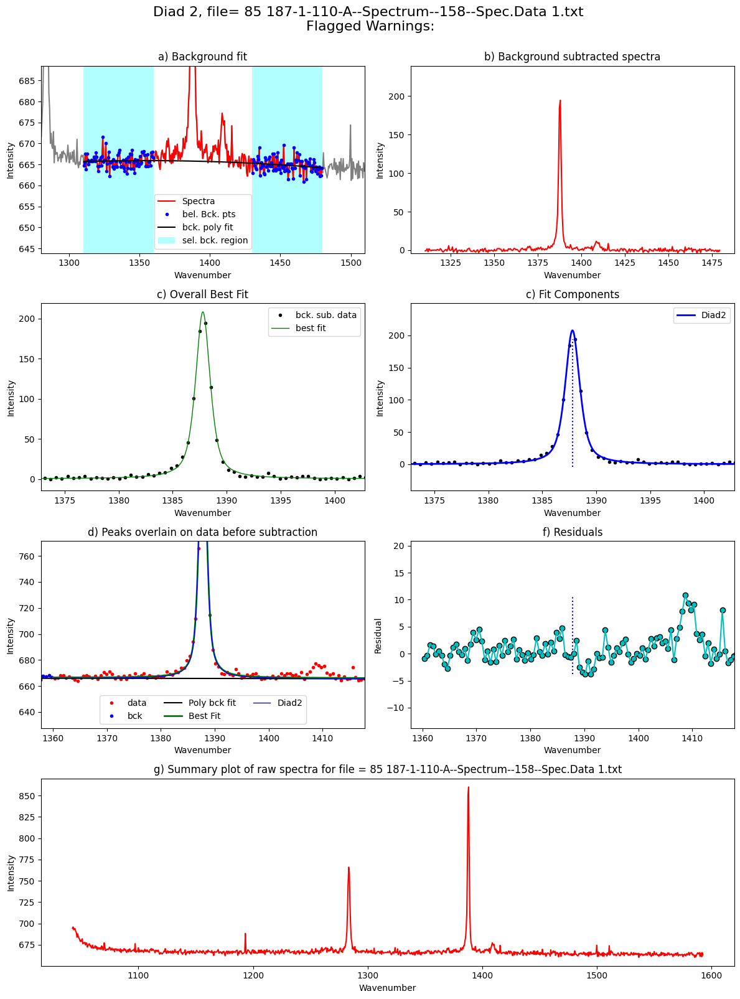

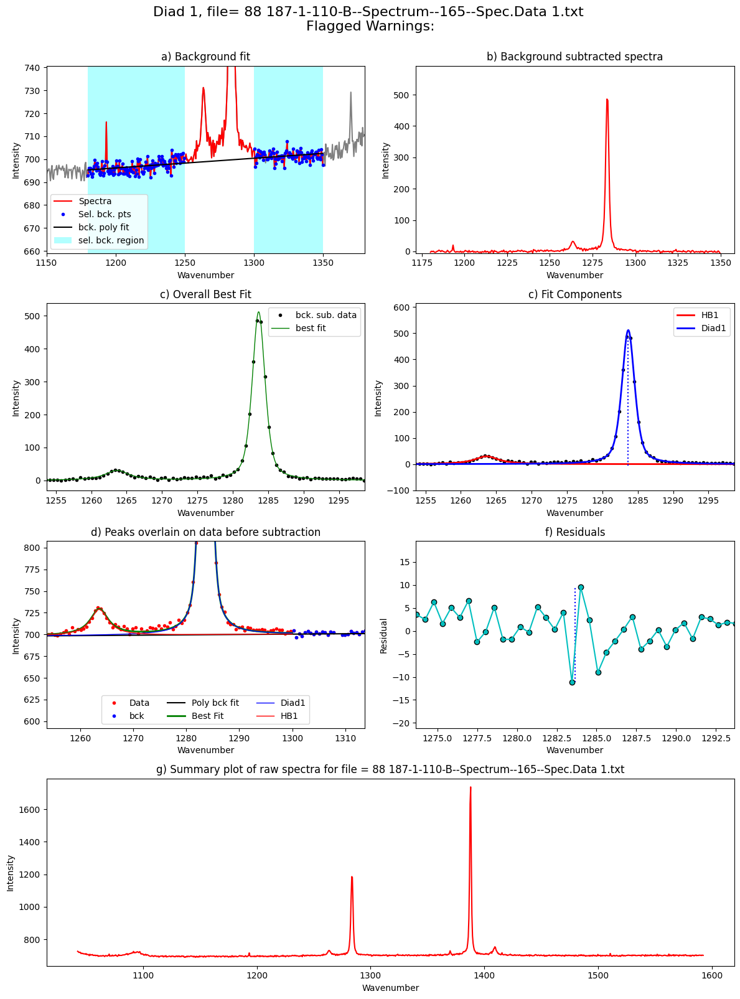

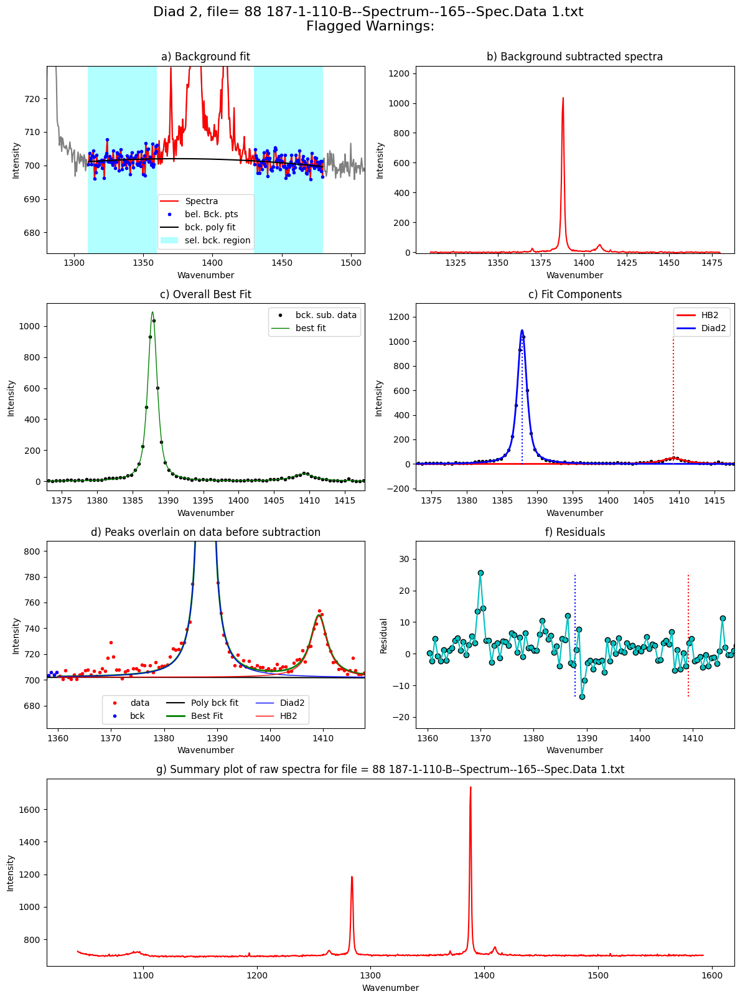

In [135]:
from tqdm import tqdm
plot_figure=True# If False, Means doesnt have to make figures, lot faster. 
close_figure=False # If True, wont show figures in notebook, but will still save them in a folder 
Diad_Files_i=Diad_Files
df_Merge = pd.DataFrame([])
for i in tqdm(range(0, len(Diad_Files))): #
    tqdm.write(f"Processing file: {Diad_Files[i]}")
    
    
    # For diad1, config file like you had in the previous. 
    # Only really used to exclude a range (say your spectra has a known spec)
    diad_id_config=pf.diad_id_config(exclude_range1=[1308, 1309])
    
    # Here, the prominence are taken from the fitting in the last notebook
    diad1_fit_config2.HB_prom=GroupN_df['HB1_abs_prom'].iloc[i]
    diad1_fit_config2.diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i]
    diad1_fit_config2.gauss_amp=2*GroupN_df['HB1_abs_prom'].iloc[i]

    Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config2,
    config2=diad_id_config, path=spectra_path, filename=GroupN_df['filename'].iloc[i],
    filetype=filetype, plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
    HB_pos=GroupN_df['HB1_pos'].iloc[i])

    ## Same for diad2, just also has a C13 peak
    diad2_fit_config_init.HB_prom=GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i]
    diad2_fit_config_init.gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.C13_prom=GroupN_df['C13_abs_prom'].iloc[i]
    
    
    Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
        config2=diad_id_config,
    path=spectra_path, filename=GroupN_df['filename'].iloc[i], 
    filetype=filetype,
    plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
    HB_pos=GroupN_df['HB2_pos'].iloc[i], 
    C13_pos=GroupN_df['C13_pos'].iloc[i])
    
    # This combines the outputs into a single dataframe
    data=pf.combine_diad_outputs(filename=GroupN_df['filename'].iloc[i], prefix=prefix, 
    Diad1_fit=Diad1_fit, path=spectra_path,                  
    Diad2_fit=Diad2_fit)        
    
 

    df_Merge = pd.concat([df_Merge, data], axis=0).reset_index(drop=True)


## You can choose to refit a subset if they are weird by using a filter

In [129]:
import copy

refit_group=GroupN_df[GroupN_df['filename'].str.contains("187-1-107-B")] # select ones you want to refit using some kind of filter, here we filter by name.

if refit_group.empty==False:
    Diad_Files_refit=Diad_Files[refit_group.index]

    diad1_fit_config_refit=copy.deepcopy(diad1_fit_config_init) # this ensures the original parameters aren't touched
    diad1_fit_config_refit.update_par(lower_bck_diad1=(1230, 1250),upper_bck_diad1=(1290, 1305)) # update parameters for refit

    diad2_fit_config_refit=copy.deepcopy(diad2_fit_config_init) # this ensures the original parameters aren't touched
    diad2_fit_config_refit.update_par(lower_bck_diad2=(1320, 1370),upper_bck_diad2=(1410, 1440)) #update parameters for refit

    diad2_fit_config_refit

diad1_fit_config(model_name='PseudoVoigtModel', fit_peaks=2, N_poly_bck_diad1=1, lower_bck_diad1=(1230, 1250), upper_bck_diad1=(1290, 1305), fit_gauss=False, gauss_amp=1000, diad_sigma=0.6, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=152.18750965313734, HB_prom=nan, x_range_baseline=30, y_range_baseline=100, dpi=200, x_range_residual=10, return_other_params=False)

,Diad2_Combofit_Cent,Diad2_Voigt_Cent,Diad2_cent_err,Diad2_Voigt_Area,Diad2_Voigt_Sigma,Diad2_Voigt_Gamma,Diad2_Combofit_Height,Diad2_Residual,Diad2_Prop_Lor,Diad2_fwhm,Diad2_refit,Diad2_Asym50,Diad2_Asym70,Diad2_Yuan2017_sym_factor,Diad2_Remigi2021_BSF
0,1388.460516,1388.460516,0.011591,399.210169,0.680649,0,213.416797,2.786878,0.701175,1.361299,Flagged Warnings:,1.184573,1.182711,0.251259,0.006379


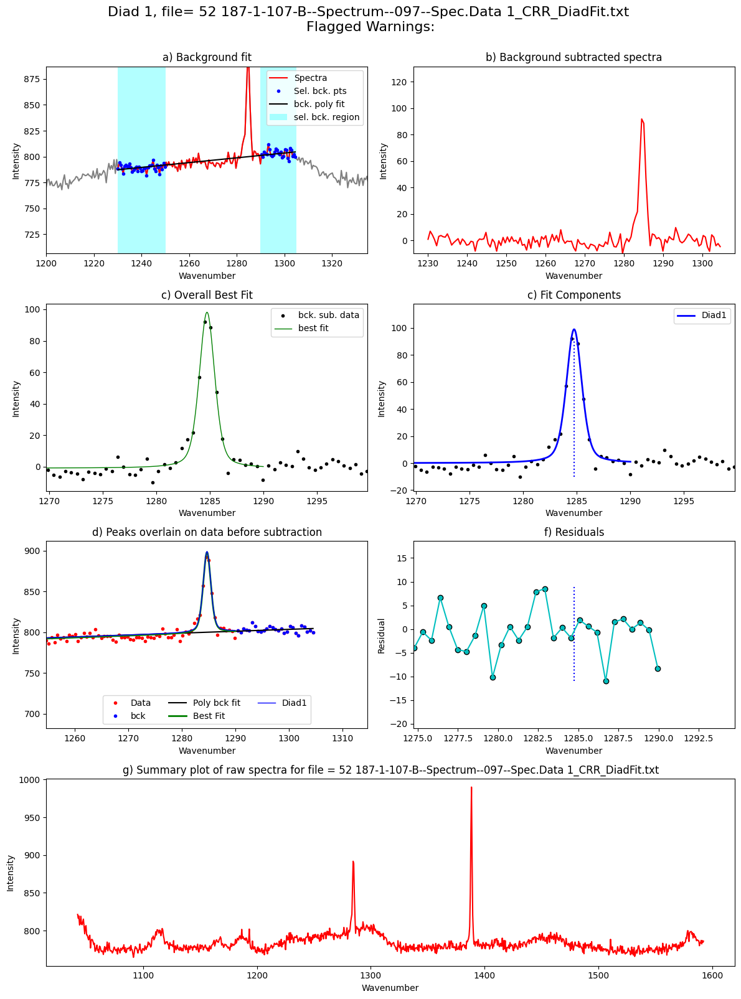

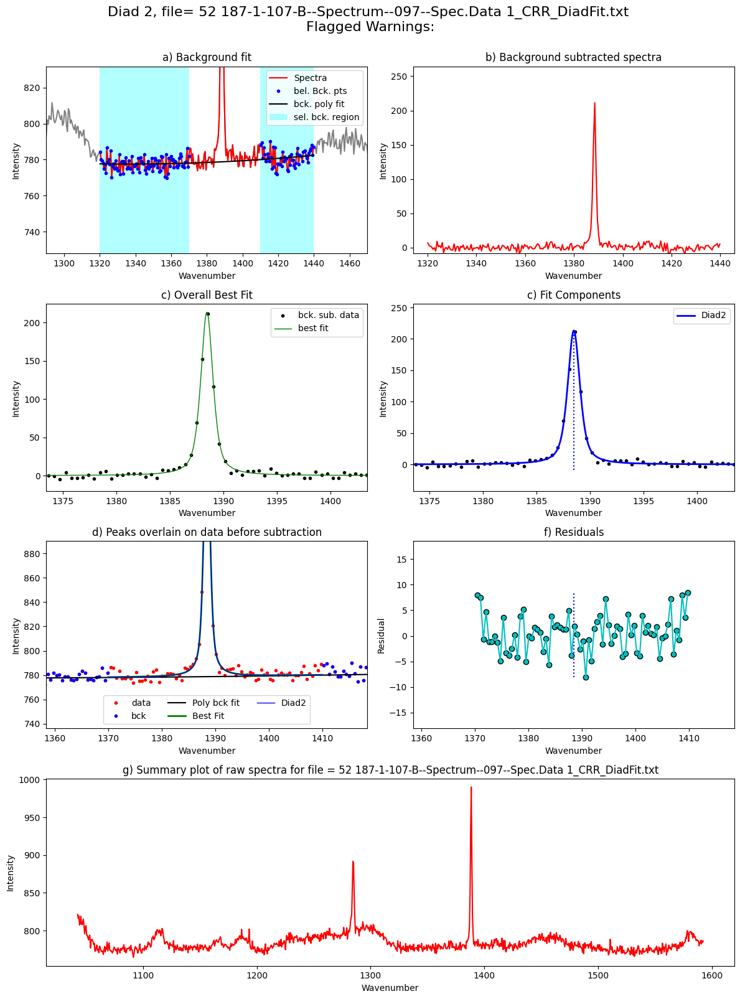

In [133]:
i=0 # pick one to try (based on iloc so even if the true index starts at 30, it is considered 0 by iloc)

if refit_group.empty==False:
    Diad1_fit_refit=pf.fit_diad_1_w_bck(config1=diad1_fit_config_refit,
    config2=diad_id_config,
    path=spectra_path, filename=Diad_Files_refit.iloc[i],
    filetype=filetype, plot_figure=True, close_figure=False,
    Diad_pos=refit_group['Diad1_pos'].iloc[i],
    HB_pos=refit_group['HB1_pos'].iloc[i])
    Diad1_fit_refit

    Diad2_fit_refit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_refit,
        config2=diad_id_config,
    path=spectra_path, filename=Diad_Files_refit.iloc[i], filetype=filetype,
    plot_figure=True, close_figure=False, 
    Diad_pos=refit_group['Diad2_pos'].iloc[i],
    HB_pos=refit_group['HB2_pos'].iloc[i], 
    C13_pos=refit_group['C13_pos'].iloc[i])
    Diad2_fit_refit.to_clipboard(excel=True)
    Diad2_fit_refit


  0%|          | 0/3 [00:00<?, ?it/s]

Processing file: 52 187-1-107-B--Spectrum--097--Spec.Data 1_CRR_DiadFit.txt


 33%|███▎      | 1/3 [00:01<00:03,  1.88s/it]

Processing file: 53 187-1-107-B--Spectrum--098--Spec.Data 1.txt


 67%|██████▋   | 2/3 [00:04<00:02,  2.07s/it]

Processing file: 54 187-1-107-B--Spectrum--099--Spec.Data 1.txt


100%|██████████| 3/3 [00:05<00:00,  1.97s/it]


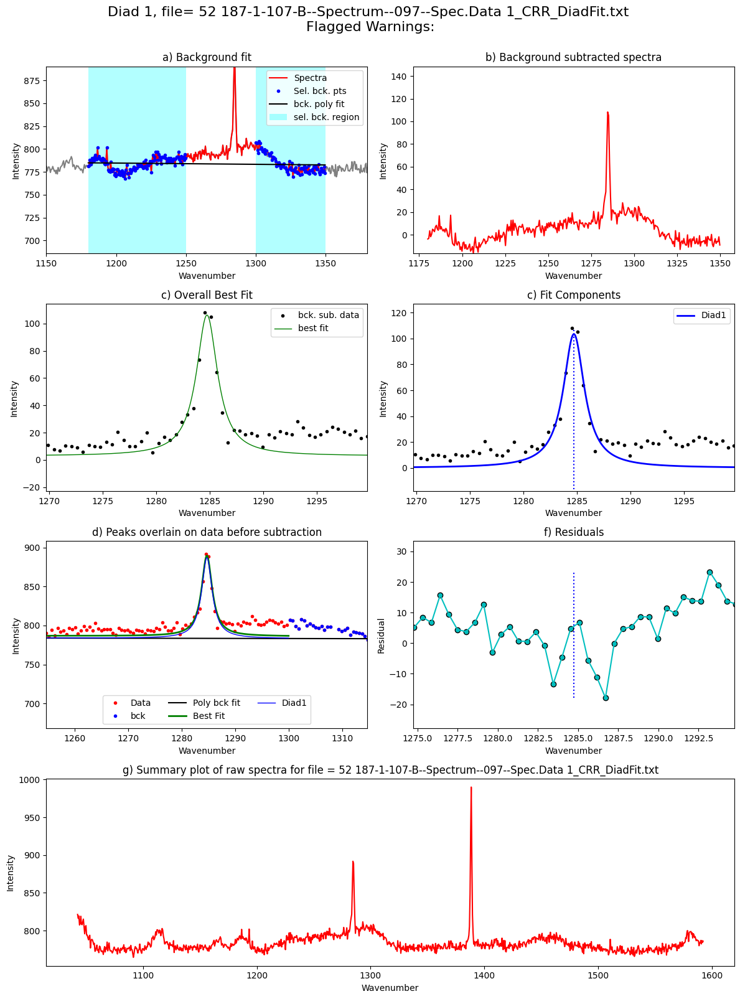

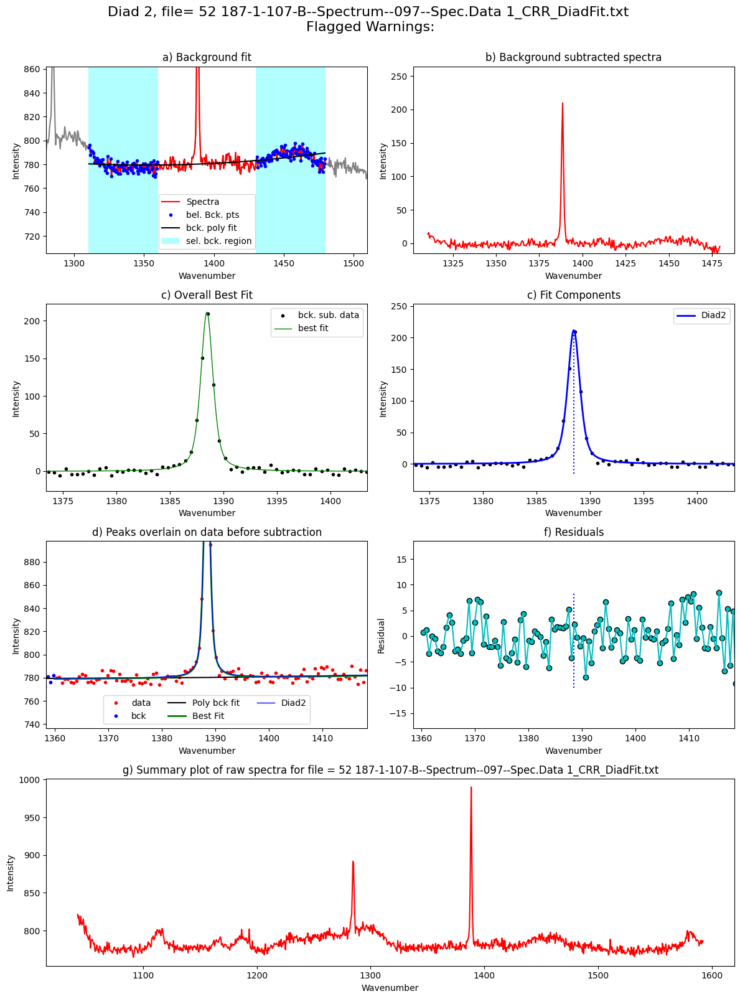

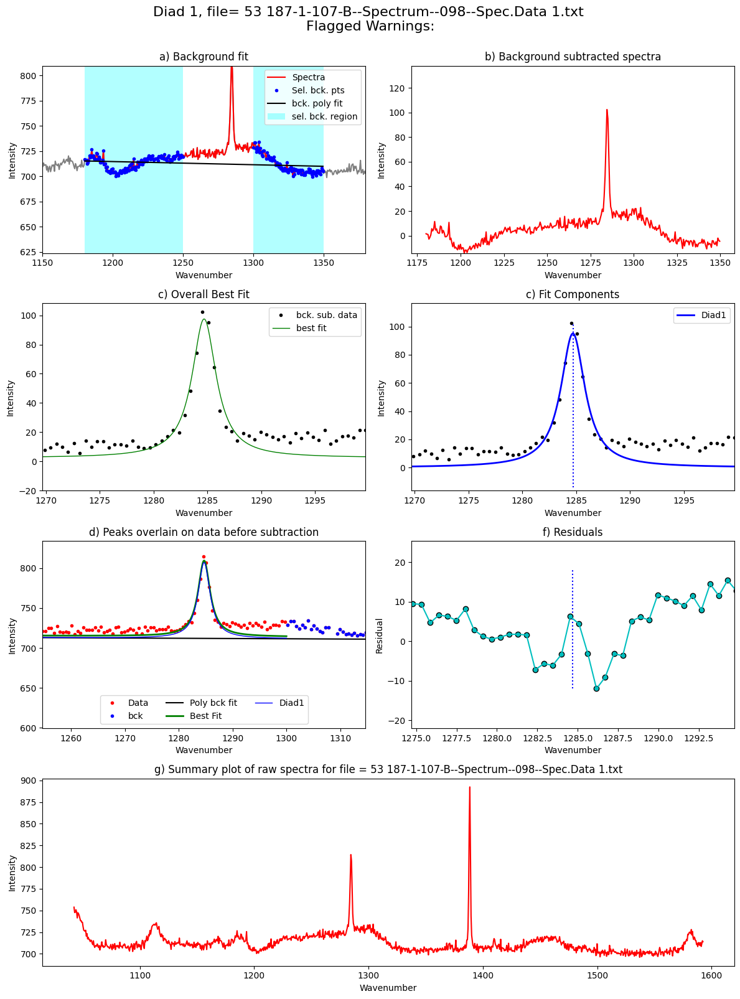

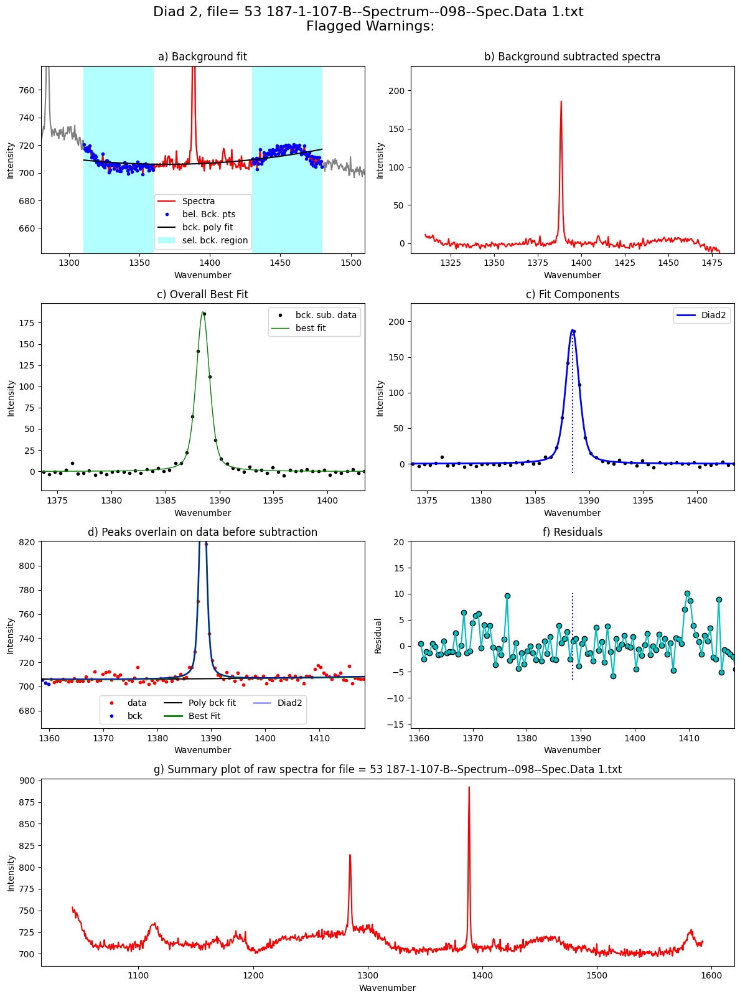

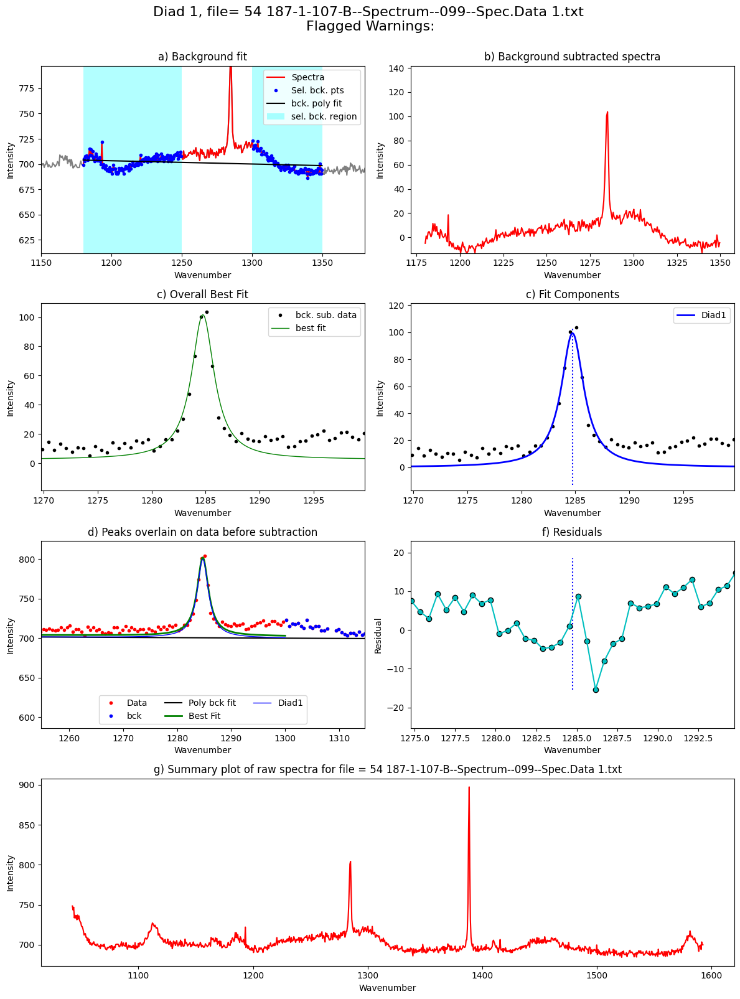

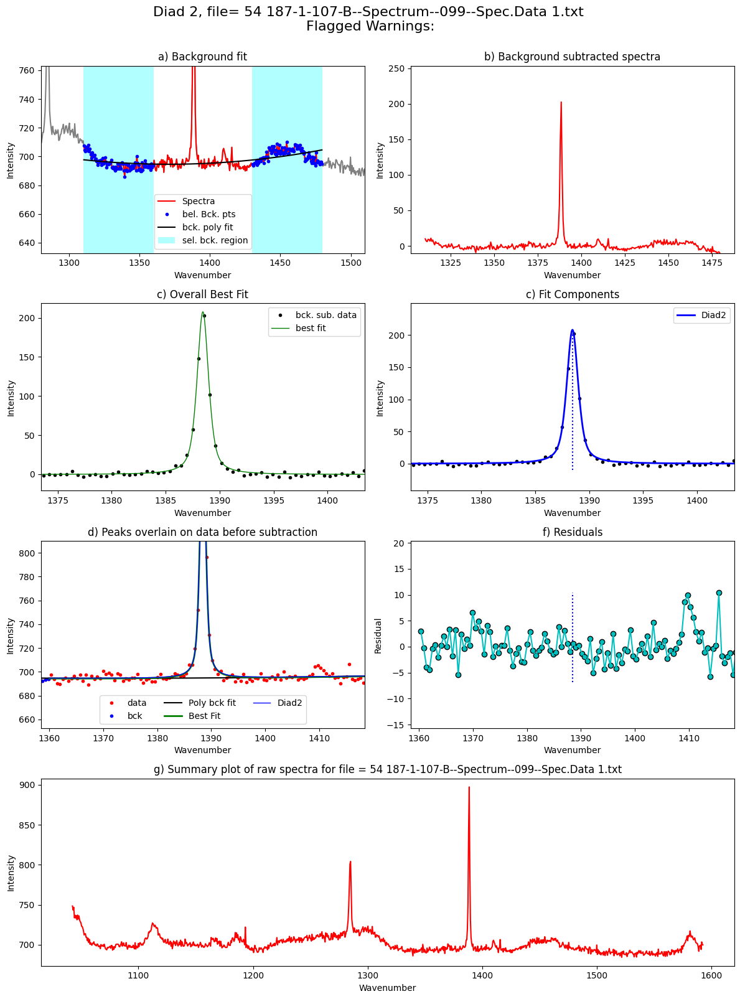

In [134]:
# Loop over all the files to refit and replace the rows in main frame

if refit_group.empty==False:
    plot_figure=True# If False, Means doesnt have to make figures, lot faster. 
    close_figure=False # If True, wont show figures in notebook, but will still save them in a folder 
    Diad_Files_i=Diad_Files_refit
    df_Merge_refit = pd.DataFrame([])
    for i in tqdm(range(0, len(Diad_Files_refit))): #
        tqdm.write(f"Processing file: {Diad_Files_refit.iloc[i]}")
        
        
        # For diad1, config file like you had in the previous. 
        # Only really used to exclude a range (say your spectra has a known spec)
        diad_id_config=pf.diad_id_config(exclude_range1=[1308, 1309])
        
        # Here, the prominence are taken from the fitting in the last notebook
        diad1_fit_config2.HB_prom=refit_group['HB1_abs_prom'].iloc[i]
        diad1_fit_config2.diad_prom=refit_group['Diad1_abs_prom'].iloc[i]
        diad1_fit_config2.gauss_amp=2*refit_group['HB1_abs_prom'].iloc[i]

        Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config2,
        config2=diad_id_config, path=spectra_path, filename=refit_group['filename'].iloc[i],
        filetype=filetype, plot_figure=plot_figure, close_figure=close_figure,
        Diad_pos=refit_group['Diad1_pos'].iloc[i],
        HB_pos=refit_group['HB1_pos'].iloc[i])

        ## Same for diad2, just also has a C13 peak
        diad2_fit_config_init.HB_prom=refit_group['HB2_abs_prom'].iloc[i]
        diad2_fit_config_init.diad_prom=refit_group['Diad2_abs_prom'].iloc[i]
        diad2_fit_config_init.gauss_amp= 2*refit_group['HB2_abs_prom'].iloc[i]
        diad2_fit_config_init.C13_prom=refit_group['C13_abs_prom'].iloc[i]
        
        
        Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
            config2=diad_id_config,
        path=spectra_path, filename=refit_group['filename'].iloc[i], 
        filetype=filetype,
        plot_figure=plot_figure, close_figure=close_figure,
        Diad_pos=refit_group['Diad2_pos'].iloc[i],
        HB_pos=refit_group['HB2_pos'].iloc[i], 
        C13_pos=refit_group['C13_pos'].iloc[i])
        
        # This combines the outputs into a single dataframe
        data=pf.combine_diad_outputs(filename=refit_group['filename'].iloc[i], prefix=prefix, 
        Diad1_fit=Diad1_fit, path=spectra_path,                  
        Diad2_fit=Diad2_fit)        
        
    

        df_Merge_refit = pd.concat([df_Merge_refit, data], axis=0).reset_index(drop=True)
    df_Merge_refit.index = Diad_Files_i.index

if refit_group.empty==False:
    display(df_Merge_refit)
    df_Merge.update(df_Merge_refit)

In [ ]:
# Save parameters to excel
combo=df_Merge

if batch=='Weak':
    combo.to_excel('Weak_Diads.xlsx', index=False)
if batch=='Medium':
    combo.to_excel('Medium_Diads.xlsx', index=False)
if batch=='Strong':
    combo.to_excel('Strong_Diads.xlsx', index=False)

In [14]:
combo

,filename,Splitting,Split_σ,Diad1_Combofit_Cent,Diad1_cent_err,Diad1_Combofit_Height,Diad1_Voigt_Cent,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Residual,...,Diad1_Gauss_Area,Diad1_Gauss_Sigma,Diad1_Asym50,Diad1_Asym70,Diad1_Yuan2017_sym_factor,Diad1_Remigi2021_BSF,Diad2_Asym50,Diad2_Asym70,Diad2_Yuan2017_sym_factor,Diad2_Remigi2021_BSF
0,187-1-102-A--Spectrum--019--Spec.Data 1_CRR_Di...,103.718374,0.008597,1284.834991,0.008081,354.649954,1284.834991,875.120124,0.912637,3.579739,...,NaN,NaN,1.256303,1.281899,0.467823,0.005147,1.022500,1.070270,0.030601,0.001926
1,187-1-102-A--Spectrum--020--Spec.Data 1_CRR_Di...,103.687495,0.009344,1284.867612,0.008875,360.714960,1284.867612,897.903344,0.912859,4.111158,...,NaN,NaN,1.317597,1.364615,0.579842,0.005061,1.027778,1.104779,0.037530,0.001842
2,187-1-102-A--Spectrum--021--Spec.Data 1,103.698905,0.008779,1284.856608,0.008138,377.161412,1284.856608,943.551209,0.924251,3.891611,...,NaN,NaN,1.365011,1.336874,0.674723,0.004901,1.032419,1.087591,0.044229,0.001771
3,187-1-102-B--Spectrum--025--Spec.Data 1,103.854672,0.038983,1284.492115,0.038074,71.386620,1284.492115,183.267244,1.003548,1.408031,...,NaN,NaN,1.009885,1.052830,0.019840,0.028116,1.110048,1.154255,0.156288,0.009485
4,187-1-102-B--Spectrum--026--Spec.Data 1_CRR_Di...,103.805771,0.029563,1284.565866,0.027283,51.408134,1284.565866,133.841943,1.019298,1.212800,...,NaN,NaN,1.172348,1.271141,0.351349,0.039655,1.062791,1.070588,0.091767,0.013438
5,187-1-102-B--Spectrum--027--Spec.Data 1,103.889816,0.048462,1284.470480,0.046504,36.387302,1284.470480,103.389965,1.064835,1.192297,...,NaN,NaN,1.446970,1.251295,0.951898,0.058528,1.281337,1.228516,0.365177,0.015341
6,187-1-102-C--Spectrum--031--Spec.Data 1_CRR_Di...,103.856516,0.014926,1284.502782,0.013872,235.229499,1284.502782,650.701771,1.048318,3.474907,...,NaN,NaN,1.227191,1.294350,0.476338,0.008913,1.120393,1.135957,0.170317,0.002809
7,187-1-102-C--Spectrum--032--Spec.Data 1,103.819555,0.013768,1284.534988,0.013032,241.785560,1284.534988,668.616550,0.993824,3.468800,...,NaN,NaN,1.093525,1.267366,0.185895,0.008221,1.170732,1.167832,0.250888,0.002927
8,187-1-102-C--Spectrum--033--Spec.Data 1,103.848504,0.015635,1284.485256,0.014627,231.990858,1284.485256,644.505407,1.018715,3.533229,...,NaN,NaN,1.197861,1.239102,0.403128,0.008782,1.167476,1.178322,0.247156,0.003040
9,187-1-102-B--Spectrum--036--Spec.Data 1,103.853265,0.006619,1284.484193,0.006066,585.017667,1284.484243,1653.044199,1.045414,4.139640,...,NaN,NaN,1.088629,1.159601,0.185307,0.003574,1.186104,1.183746,0.268811,0.001141


### This plays a sound when the notebook is done if you have a tendency to procrastinate

In [15]:
# !pip install winotify

from winotify import Notification, audio

toast= Notification(app_id="VSCode",title="Notebook completed",
                    msg="Step3b_Secondary_Peaks is done!",
                    duration="short")
toast.set_audio(audio.Mail,loop=False)
toast.show()